In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
from scipy import signal

In [2]:
# Make the plots a bit bigger to see
# NOTE: Must be done in a separate cell
plt.rcParams['figure.dpi'] = 100

In [3]:
# path = "Data/run17_v/"
# path1 = "Data_ccr/par_set_2_psd/vrun4_d2_40/"
# path1 = "Data_ccr/par_set_2_psd/trun2_d1/"
# path1 = "../NoneqTrans2/Data_test/par_set1/vrun1_d1_85/"
# path1 = "../NoneqTrans2/Data_test/80x80/vrun2_d1_40/"
path1 = "../../../../../../Volumes/Kunal_EHD/Work/Codes/RS_data_122920/par_set1_cbc/vrun1_d2_85/"
# path2 = "../NoneqTrans2/Data_test/vrun2_d1_40/"
# Python Data Single run
A1 = np.loadtxt(path1 + "delta_f2py_test.dat")
nn = np.size(A1,0)
print(np.shape(A1))

#### Python Data Voltage Up
E_up = A1[:,0]
# T_up = A1[:,0]
delta_up = A1[:,1]
I_up = A1[:,6]
Vs_up = A1[:,4]
R_up = A1[:,7]
# dR_up = A1[:,9]
mx = 64
my = 64
Nsamp = 512

# V_crit = 947.2
V_crit = 672.0
inputs = open(path1+"input_par.dat", "r")

print(inputs.read())

(200, 11)
{'mx': 64, 'my': 64, 'nwarm': 400000, 'nskip': 16, 'Tc': 1.0, 'coef': 0.1, 'dphi': 0.2, 'gamma': 0.1, 'r0': 3.5, 'g2': 1.0, 'g4': -1.0, 'g6': 0.5, 'Rload': 1.0, 'mfphi': False, 'tloop': False}{'Tcrit': 1.32, 'dE': 0.1, 'minE': 0.1, 'maxE': 20.1, 'dTb': 0.01, 'minT': 0.01, 'maxT': 2.01, 'nmeas': 2048, 'Tbath': 0.85, 'seed': 2384824, 'NPEs': 1, 'iphi': True}


In [4]:
#### Voltage Domain plots

mxphi = []
mnphi = []

mxdphi = []
mndphi = []
for i in range(nn):
    phi = np.loadtxt(path1 + "phi_val_"+ format(E_up[i], '.2f')+ "_"+ str(Nsamp-1)+ "_.dat")
    dphi = phi - np.mean(phi)
    mxphi.append(np.max(phi))
    mnphi.append(np.min(phi))
    mxdphi.append(np.max(dphi))
    mndphi.append(np.min(dphi))


maxphi = np.max(mxphi)
minphi = np.min(mnphi)
maxdphi = np.max(mxdphi)
mindphi = np.min(mndphi)
print( minphi, maxphi)
print(mindphi, maxdphi)

-1.8777081436736216 2.2574768711797164
-2.6743984794321993 1.9304126211897288


In [5]:
#### Voltage Domain plots

rows = 20
columns = 10
fig, axes = plt.subplots(figsize=(columns*10+15, rows*10+15 ))
# fig=plt.figure(figsize=(100, 8))
fig.suptitle = "$\phi$ distribution, $T_B = 0.85*T_C$"
for i in range(rows*columns):
    phi = np.loadtxt(path1 + "phi_val_"+ format(E_up[i], '.2f')+ "_"+ str(Nsamp-1)+ "_.dat")
    fig.add_subplot(rows, columns, (i+1))
#     phi2 = phi**2
#     dist = plt.imshow(np.transpose(phi),cmap='plasma',origin='lower', vmin = minphi, vmax = maxphi)
    x, y = np.meshgrid(np.arange(mx), np.arange(my))
    plt.contourf(x,y,np.transpose(phi), cmap='plasma', origin='lower', vmin = minphi, vmax = maxphi)
#     plt.colorbar(dist)
    plt.title("Vt = "+format(E_up[i]*my, '.2f') , fontsize = 80)
    plt.xlabel("m_x")
    plt.ylabel("m_y")
# plt.legend()


# plt.title('$N_{meas}$=1024, $g_2 = 1$ , $g_4 = -1$, $g_6 = 0.5$, $r_0 = 3.5$')
# fig.colorbar(dist)
# plt.savefig(path1 + "Dist_phi_Tbath=0.75*Tc.pdf",bbox_inches='tight')

plt.show()



In [6]:
phi = np.loadtxt(path1 + "phi_val_"+ format(12.60, '.2f')+ "_"+ str(Nsamp-1)+ "_.dat")
weight = 1.0/(phi**(2))


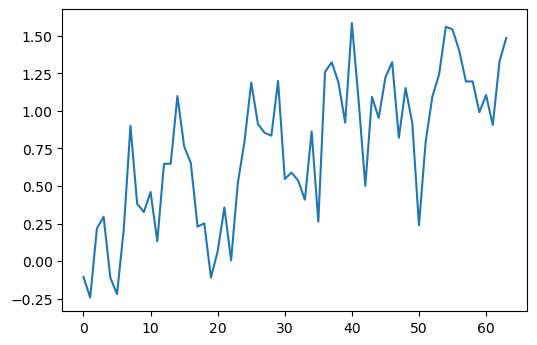

In [7]:
plt.plot(phi[:,32])

In [8]:
# x = np.arange(0.01,mx+0.01)
# # print(x)
# y = np.arange(0.01,my+0.01)
# # print(y)
x, y = np.meshgrid(np.arange(1,mx), np.arange(1,my))
print(x)
print(y)
snaps = np.arange(0,Nsamp)

[[ 1  2  3 ... 61 62 63]
 [ 1  2  3 ... 61 62 63]
 [ 1  2  3 ... 61 62 63]
 ...
 [ 1  2  3 ... 61 62 63]
 [ 1  2  3 ... 61 62 63]
 [ 1  2  3 ... 61 62 63]]
[[ 1  1  1 ...  1  1  1]
 [ 2  2  2 ...  2  2  2]
 [ 3  3  3 ...  3  3  3]
 ...
 [61 61 61 ... 61 61 61]
 [62 62 62 ... 62 62 62]
 [63 63 63 ... 63 63 63]]


In [9]:
def centre_of_fil(phi):
    weight = 1.0/(phi**2)
    com1 = 0
    com2 = 0
    for ii in range(mx):
        for jj in range(my):
            com1 += (weight[ii,jj]*ii)
            com2 += (weight[ii,jj])
    cofx = (com1)/com2        
    return cofx


In [10]:
# COFx = np.zeros(Nsamp)
# for tt in range(Nsamp):
#     phi = np.loadtxt(path1 + "phi_val_"+ format(12.60, '.2f')+ "_"+ str(tt)+ "_.dat")
# #     weight = 1.0/(phi**(2))
#     COFx[tt] = centre_of_fil(phi)
# #     print(comx)

In [11]:
# plt.scatter(snaps,COFx)
# # plt.ylim(-1.,64.)

In [12]:
# A = 3.0*np.ones((10,10))
# B = 2.0*np.ones((10,10))
# C = A*B
# print(C)
# print(C**2)

# print(np.mean(COFx))
# print(np.std(COFx))
# x, y = np.meshgrid(np.arange(mx), np.arange(my))
# plt.contourf(x,y,np.transpose(phi), cmap='plasma', origin='lower')
# plt.axvline(x = np.mean(COFx), color = 'black')
# plt.show()

In [13]:
COF = np.zeros((nn,Nsamp))
k = 0
for E in E_up:
    if E*my > V_crit:  #and E*my < 992.2: 
        for tt in range(Nsamp):
            phi = np.loadtxt(path1 + "phi_val_"+ format(E, '.2f')+ "_"+ str(tt)+ "_.dat")
#     weight = 1.0/(phi**(2))
            COF[k,tt] = centre_of_fil(phi)
    k += 1
#     print(comx)

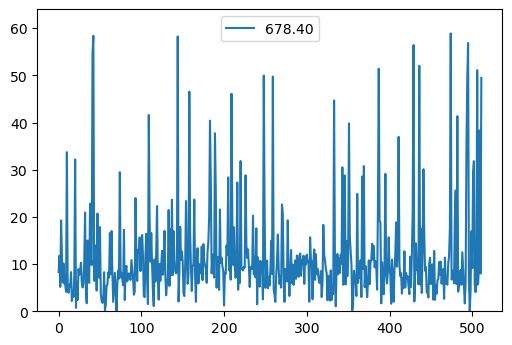

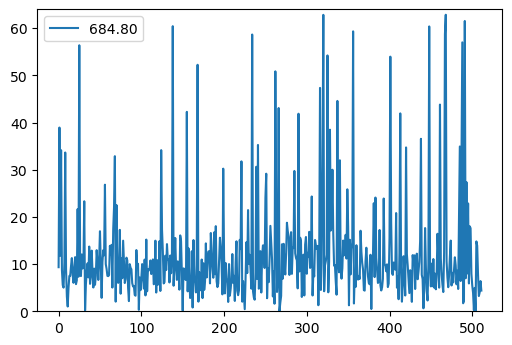

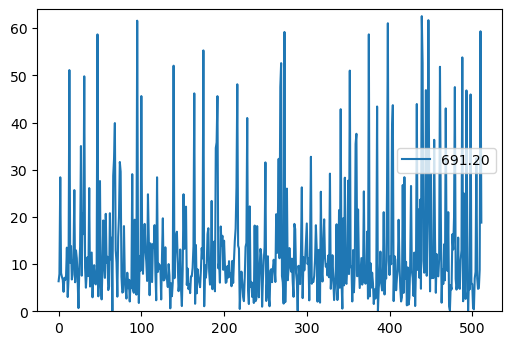

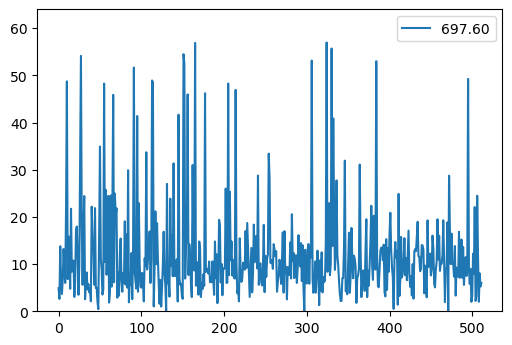

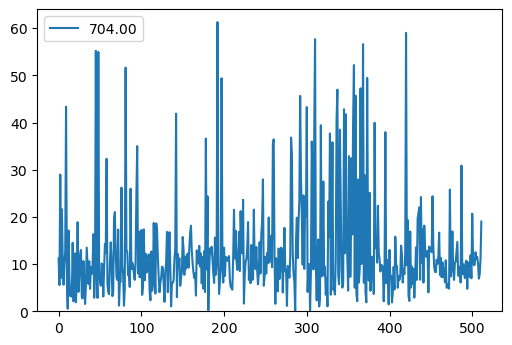

...

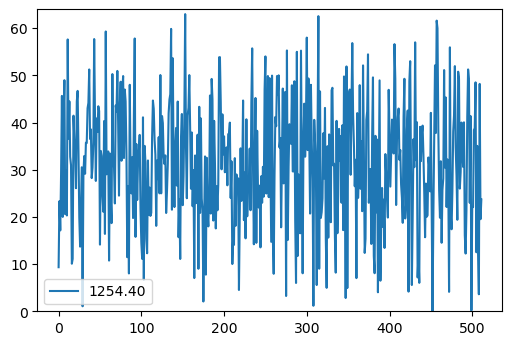

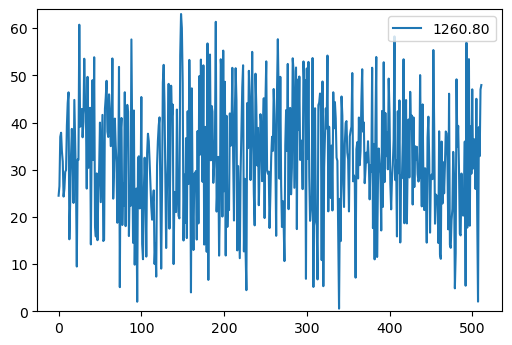

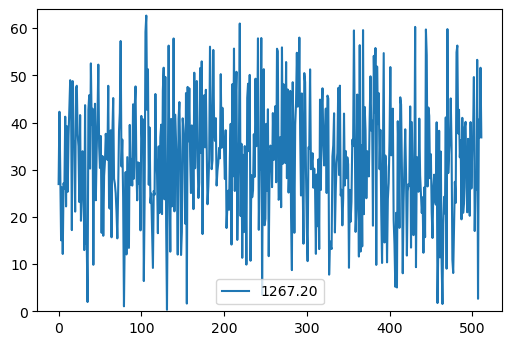

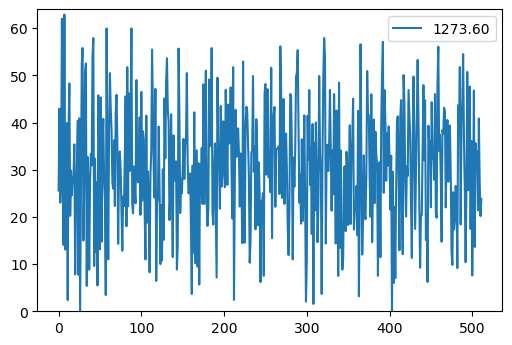

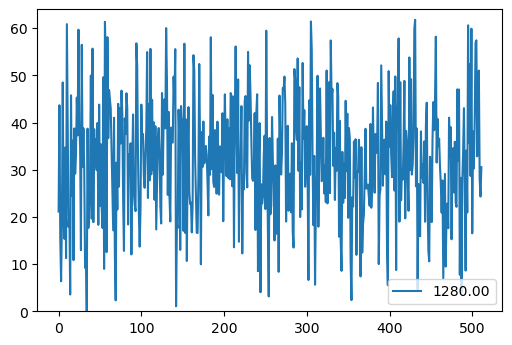

In [14]:
for k in range(nn):
    if E_up[k]*my > V_crit: # and E_up[k]*my < 992.2:
        plt.plot(snaps,COF[k,:], label = format(E_up[k]*my, '.2f'))
        plt.legend()
        plt.ylim(0,64)
        plt.show()


In [15]:
COF_mean = np.mean(COF,axis=1)
COF_dev = np.std(COF,axis=1)

# print(COF_mean)

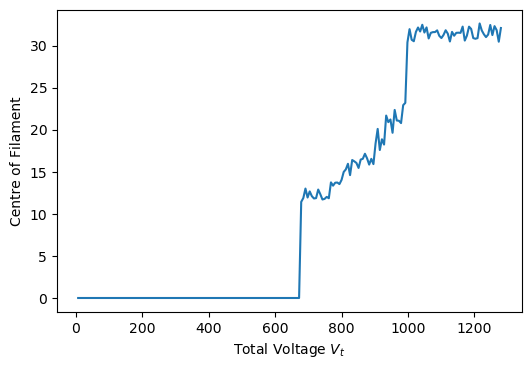

In [16]:
plt.plot(E_up*my,COF_mean)
plt.ylabel("Centre of Filament")
plt.xlabel("Total Voltage $V_t$")
# plt.axhline(y=32., color = 'grey', linestyle = 'dashed')
# plt.axvline(x= V_crit, color='black' , linestyle = 'dashed')
plt.show()

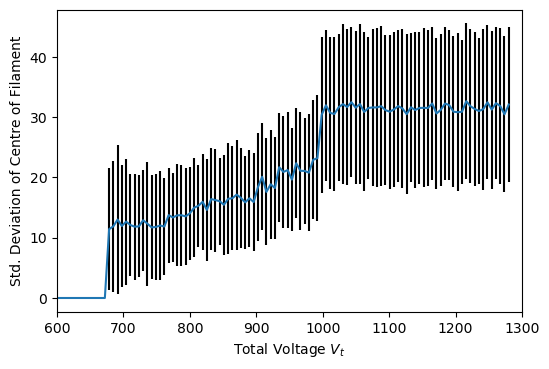

In [20]:
plt.errorbar(E_up*my,COF_mean,yerr = COF_dev, ecolor = 'black')
plt.ylabel("Std. Deviation of Centre of Filament")
plt.xlabel("Total Voltage $V_t$")
plt.xlim(600,1300)
# plt.axhline(y=32., color = 'grey', linestyle = 'dashed')
# plt.axvline(x= V_crit, color='black' , linestyle = 'dashed')
plt.show()